In [2]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt
from eli5.sklearn import PermutationImportance
%matplotlib inline

In [3]:
df = pd.read_csv('integral_data.csv',)
#names=['url','unit_price','total_price','community','community_url','district','loaction','huxing','floor','building','available','huxing_type','face_to','building_struct','buliding_type','decoration','elevator_rate','elevator','property_year','trade_type','house_usage','limit_year','proper_belong','mortgage','tags','feature','title','subtitle'] )

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43106 entries, 0 to 43105
Data columns (total 44 columns):
url                    43106 non-null object
unit_price             43106 non-null int64
total_price            43106 non-null float64
community              43106 non-null object
community_url          43106 non-null object
district               43106 non-null object
location               43106 non-null object
huxing                 43106 non-null object
floor                  43106 non-null object
building_area          43106 non-null object
available_area         43106 non-null object
huxing_type            43106 non-null object
face_to                43106 non-null object
building_structure     43106 non-null object
building_type          43106 non-null object
decoration             43106 non-null object
elevator_rate          43106 non-null object
elevator               43106 non-null object
property_year          43106 non-null object
trade_type             43106 non-nul

In [7]:
df.head()

,url,unit_price,total_price,community,community_url,district,location,huxing,floor,building_area,...,huxing_chu,huxing_wei,floor_float,building_area_float,face_N,face_S,face_E,face_W,elevator_01,elevator_rate.1
0,https://sh.lianjia.com/ershoufang/107101283505...,32043,168.0,竹园小区(嘉定),https://sh.lianjia.com/xiaoqu/5011000009197/,嘉定,菊园新区,1室1厅1厨1卫,中楼层 (共6层),52.43㎡,...,1,1,3.0,52.43,0,1,0,0,0,0.500000
1,https://sh.lianjia.com/ershoufang/107101406559...,32965,295.0,合景叠翠峰苑,https://sh.lianjia.com/xiaoqu/5011000001232/,嘉定,菊园新区,3室2厅1厨1卫,高楼层 (共18层),89.49㎡,...,1,1,18.0,89.49,0,1,0,0,1,0.666667
2,https://sh.lianjia.com/ershoufang/107101396267...,32385,290.0,万科金色领域,https://sh.lianjia.com/xiaoqu/5011000002786/,嘉定,菊园新区,3室2厅1厨1卫,中楼层 (共11层),89.55㎡,...,1,1,5.5,89.55,1,1,0,0,1,0.500000
3,https://sh.lianjia.com/ershoufang/107101258518...,26411,212.0,嘉邦小区,https://sh.lianjia.com/xiaoqu/5011000013124/,嘉定,菊园新区,2室1厅1厨1卫,高楼层 (共6层),80.27㎡,...,1,1,6.0,80.27,0,1,0,0,0,0.500000
4,https://sh.lianjia.com/ershoufang/107101161750...,29944,212.0,嘉富小区,https://sh.lianjia.com/xiaoqu/5011000004924/,嘉定,菊园新区,2室1厅1厨1卫,中楼层 (共6层),70.8㎡,...,1,1,3.0,70.80,0,1,0,0,0,0.500000


In [3]:
df.info()

NameError: name 'df' is not defined

In [7]:
df.unit_price.describe()

count     66880.000000
mean      53427.704336
std       24508.319066
min        7147.000000
25%       35944.750000
50%       49822.000000
75%       65918.250000
max      527406.000000
Name: unit_price, dtype: float64

skew:  1.5998649627147334


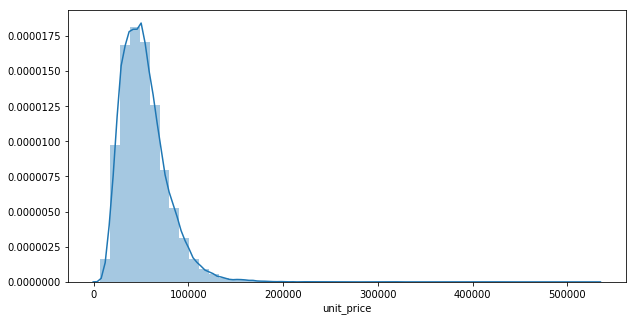

In [8]:
plt.figure(figsize = (10,5))
print("skew: ",df.unit_price.skew())
sns.distplot(df['unit_price'])

skew:  5.552677717739647


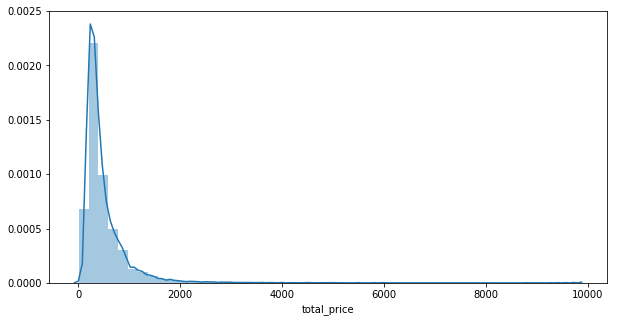

In [9]:
plt.figure(figsize = (10,5))
print("skew: ",df.total_price.skew())
sns.distplot(df['total_price'])

In [10]:
from pyecharts import Bar
city_count_series=df.groupby('district')['url'].count().sort_values(ascending=False)
city_count_x=city_count_series.index.tolist()
city_count_y=city_count_series.values.tolist()
city_count_bar=Bar("num in diffrent district")
city_count_bar.add('',x_axis=city_count_x,y_axis=city_count_y,is_label_show=True,is_datazoom_show=True,x_rotate=30)
city_count_bar

In [11]:
from pyecharts_javascripthon.dom import window

def custom_formatter(params):
    return window.parseFloat(params.value).toFixed(1)

df_price_unit=df[df.unit_price!=0 ]
df_price_total=df[df.total_price!=0]
price_avg_series=df_price_unit.groupby('district')['unit_price'].mean().sort_values(ascending=False)
total_price_series=df_price_total.groupby('district')['total_price'].mean().sort_values(ascending=False)
price_avg_x=price_avg_series.index
price_avg_y=price_avg_series.values
total_price_x=total_price_series.index
total_price_y=total_price_series.values
price_avg_plot=Bar('各地区房屋均价')
price_avg_plot.add('单位面积价格（元/平米）',x_axis=price_avg_x,y_axis=price_avg_y,is_label_show=True,label_formatter=custom_formatter,)
price_avg_plot.add('总价(万元/套)',x_axis=total_price_x,y_axis=total_price_y,is_label_show=True,is_datazoom_show=True,x_rotate=30,label_formatter=custom_formatter,)
price_avg_plot

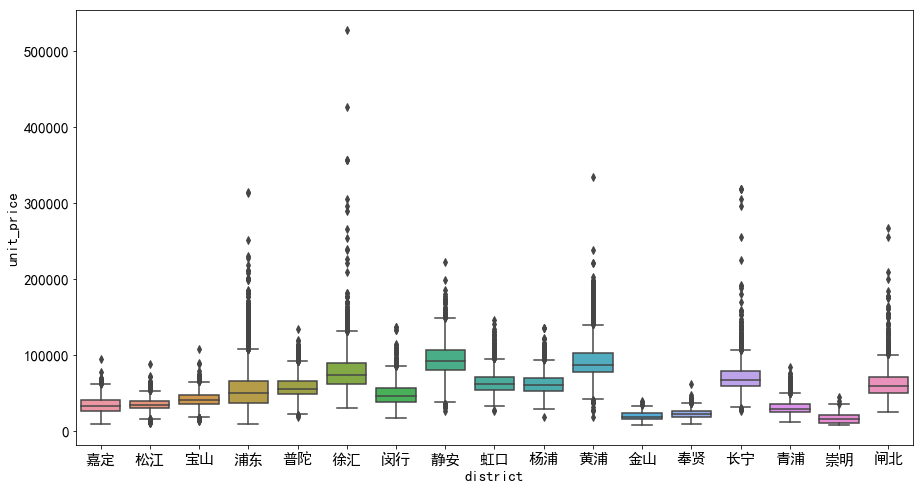

In [12]:
plt.figure(figsize=(15,8))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
sns.boxplot(df.district, df.unit_price)

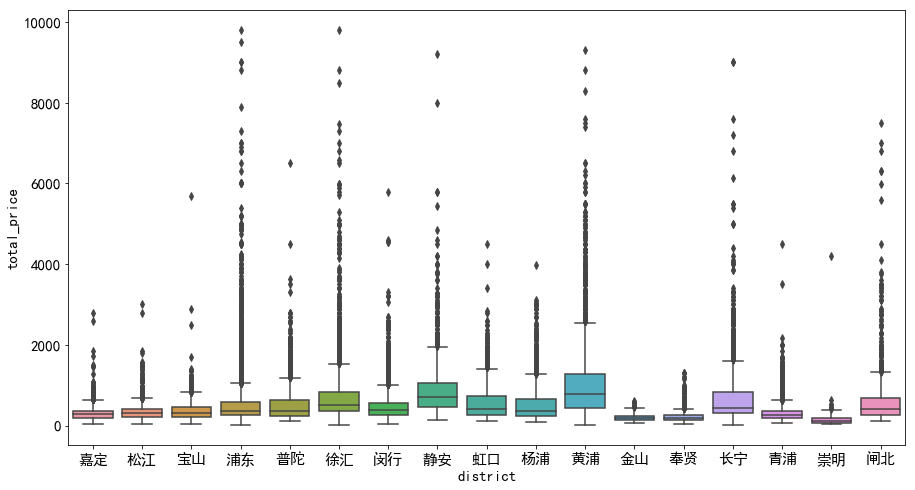

In [13]:
plt.figure(figsize=(15,8))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
sns.boxplot(df.district, df.total_price)

In [14]:
import re
bedroom=[]
for index,row in enumerate(df.huxing):
    try:
        bed_num=re.findall('\d+',row)[0]
    except:
        bed_num=-1
    bedroom.append(bed_num)
df['bedroom']=bedroom
bedroom_plot_x=df.bedroom.value_counts().index
bedroom_plot_y=df.bedroom.value_counts().values
from pyecharts import Pie
bedroom_plot=Pie('卧室数量',width=900)
bedroom_plot.add(name='卧室数量',attr=bedroom_plot_x,value=bedroom_plot_y,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
bedroom_plot


In [15]:
restroom=[]
for index,row in enumerate(df.huxing):
    try:
        rest_num=re.findall('\d+',row)[1]
    except:
        rest_num=-1
    restroom.append(rest_num)
df['restroom']=restroom
restroom_plot_x=df.restroom.value_counts().index
restroom_plot_y=df.restroom.value_counts().values
from pyecharts import Pie
restroom_plot=Pie('客厅数量',width=900)
restroom_plot.add(name='客厅数量',attr=restroom_plot_x,value=restroom_plot_y,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
restroom_plot

In [16]:
kitchen=[]
for index,row in enumerate(df.huxing):
    try:
        kitchen_num=re.findall('\d+',row)[2]
    except:
        kitchen_num=-1
    kitchen.append(kitchen_num)
df['kitchen']=kitchen
kitchen_plot_x=df.kitchen.value_counts().index
kitchen_plot_y=df.kitchen.value_counts().values
from pyecharts import Pie
kitchen_plot=Pie('厨房数量',width=900)
kitchen_plot.add(name='厨房数量',attr=kitchen_plot_x,value=kitchen_plot_y,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
kitchen_plot

In [17]:
bathroom=[]
for index,row in enumerate(df.huxing):
    try:
        rest_num=re.findall('\d+',row)[3]
    except:
        rest_num=-1
    bathroom.append(rest_num)
df['bathroom']=bathroom
bathroom_plot_x=df.bathroom.value_counts().index
bathroom_plot_y=df.bathroom.value_counts().values
from pyecharts import Pie
bathroom_plot=Pie('卫生间数量',width=900)
bathroom_plot.add(name='卫生间数量',attr=bathroom_plot_x,value=bathroom_plot_y,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
bathroom_plot

In [19]:
from pyecharts import Scatter3D
area = []
mapdict={'普通住宅':1,'商业办公类':2,'老公寓':3,'别墅':4,'新式里弄':5,'花园洋房':6,'旧式里弄':7}
def mapfunc(type):
    return mapdict[type]
for index,row in enumerate(df.building_area):
    area.append(re.findall('\d+',row)[0])
price=df.unit_price.values.tolist()
price=[i/1000 for i in price]
#area=df.building_area.values.tolist()
types=list(map(mapfunc,df.house_usage.values))

data=[]
for i in range(len(price)):
    data.append([area[i],types[i],price[i]])
scatter=Scatter3D('价格，面积和房屋类型的关系',width=700,height=700)
scatter.add('',data,is_visualmap=True,grid3d_opacity=0.8,xaxis3d_max=650,yaxis3d_max=7,zaxis3d_max=200,
           xaxis3d_name='面积(m^2)',yaxis3d_name='房屋类型',zaxis3d_name='单位价格(k/m^2)',)
scatter

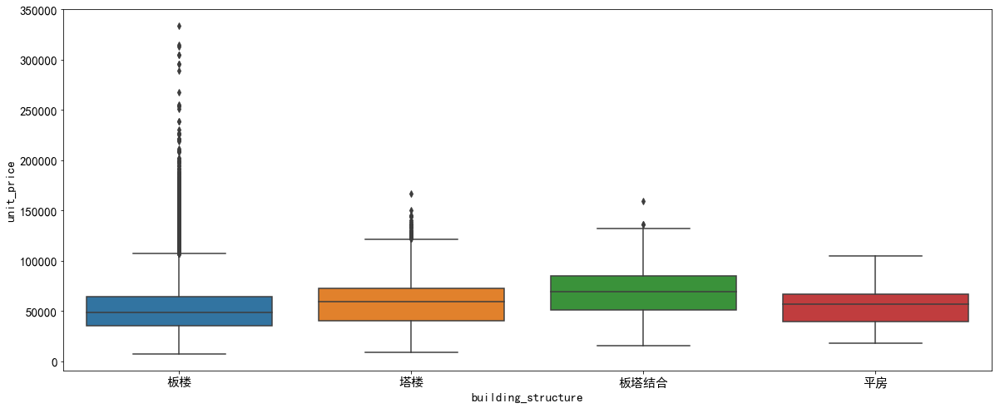

In [20]:
plt.figure(figsize=(20,8))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
building_structure = [ '板楼', '塔楼', '板塔结合', '平房']
sns.boxplot(df.building_structure,df.unit_price,order = building_structure)

In [21]:
build=df["building_structure"].value_counts()
build.pop("暂无数据")
from pyecharts import Pie
build_plot=Pie('building_structure',width=900)
build_plot.add(name='building_structure',attr=build.index,value=build.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
build_plot

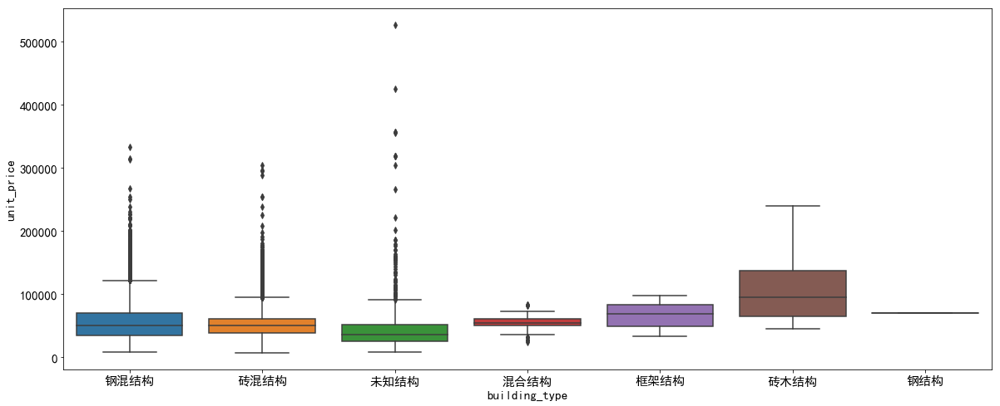

In [22]:
plt.figure(figsize=(20,8))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
building_type= ['钢混结构', '砖混结构',  '未知结构',  '混合结构', '框架结构', '砖木结构', '钢结构']
sns.boxplot(df.building_type,df.unit_price,order = building_type)

In [23]:
build=df["building_type"].value_counts()
#build.pop("暂无数据")
from pyecharts import Pie
build_type_plot=Pie('building_type',width=900)
build_type_plot.add(name='building_type',attr=build.index,value=build.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
build_type_plot

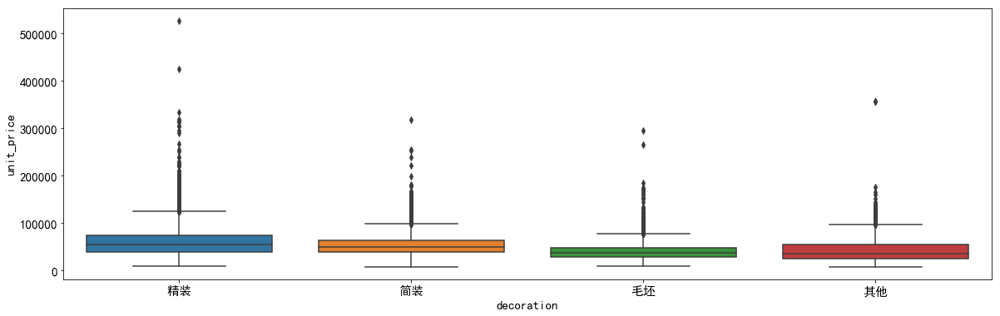

In [24]:
plt.figure(figsize=(20,6))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
decoration=['精装', '简装', '毛坯', '其他']
sns.boxplot(df.decoration,df.unit_price,order = decoration)

In [25]:
deco=df["decoration"].value_counts()
#build.pop("暂无数据")
from pyecharts import Pie
deco_plot=Pie('decoration',width=900)
deco_plot.add(name='building_type',attr=deco.index,value=deco.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
deco_plot

In [26]:
dist=df["district"].value_counts()
#build.pop("暂无数据")
from pyecharts import Pie
dist_plot=Pie('decoration',width=900)
dist_plot.add(name='building_type',attr=dist.index,value=dist.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
dist_plot

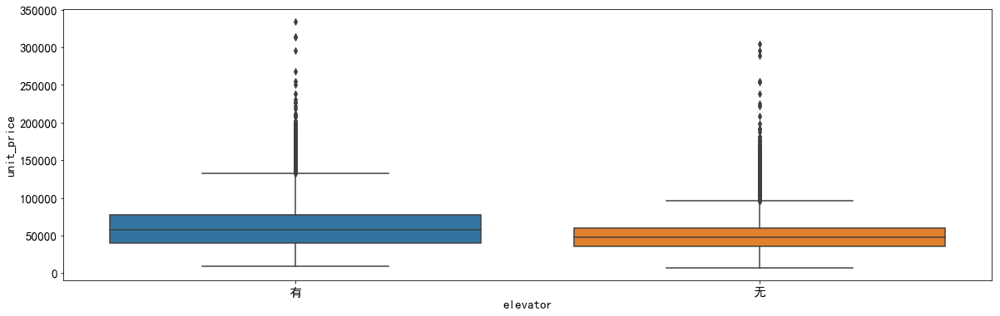

In [27]:
plt.figure(figsize=(20,6))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
elevator=['有', '无']
sns.boxplot(df.elevator,df.unit_price,order = elevator)

In [28]:
elev=df["elevator"].value_counts()
elev.pop("暂无数据")
from pyecharts import Pie
elev_plot=Pie('elevator',width=900)
elev_plot.add(name='building_type',attr=elev.index,value=elev.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
elev_plot

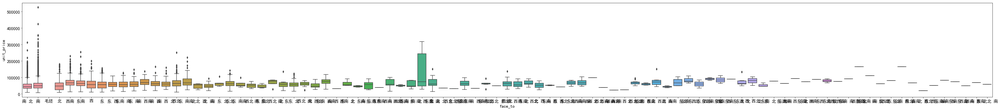

In [29]:
plt.figure(figsize=(60,6))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
face_to=['南 北', '南', '毛坯', '北', '西南', '东南', '西', '东', '东 西', '东南 南', '东 南', '南 西南', '南 西', '南 西 北', '西北', '东 南 北', '南 北 西', '北 南', '南 东 北', '东北', '东 南 西', '南 北 东', '南 东北', '南 西北 北', '南 东', '东 北', '西北 北', '南 西北', '东南 西南', '南 西 东', '西南 北', '北 东南', '南 东南', '东 东南 西南', '东南 南 西南', '西北 南', '东南 南 北', '东 南 西 北', '东南 北', '东 南 北 东北', '西北 西南', '东 东南', '东南 南 西南 北', '东 东北', '南 西北 东北', '西 北', '南 西南 北', '东南 西北', '北 西', '东南 东', '南 西 西北 北', '东 东南 南', '西南 西', '南 西 西北', '南 北 西南 西北', '西南 南', '南 西南 西 西北 北', '北 东北', '东南 东北', '西南 西北', '西 南', '西南 东北', '东南 西', '东 北 东北', '东 西南 东北', '南 西南 西', '东 东南 东北', '东 西 北', '西 西北', '北 东', '东南 北 东北', '东 西南', '西南 西 东北', '东 北 西', '南 西南 西 北', '东 东南 北', '西 西南', '东 东南 南 西南', '西 东北', '东 东南 南 北', '南 东 西', '西北 东北', '东 东南 南 西', '东北 南', '南 北 东 西', '西北 东南', '东 西南 西', '南 东南 西南', '东 北 南', '西南 西 北', '东南 北 南']
sns.boxplot(df.face_to,df.unit_price,order = face_to)

In [30]:
face=df["face_to"].value_counts()
face.pop("暂无数据")
from pyecharts import Pie
face_plot=Pie('face_to',width=900)
face_plot.add(name='building_type',attr=face.index,value=face.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
face_plot

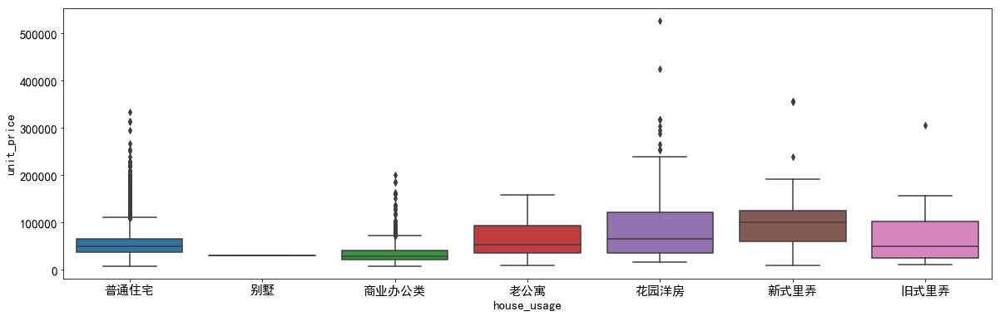

In [31]:
plt.figure(figsize=(20,6))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
house_usage=['普通住宅', '别墅', '商业办公类', '老公寓', '花园洋房', '新式里弄', '旧式里弄']
sns.boxplot(df.house_usage,df.unit_price,order = house_usage)

In [32]:
house=df["house_usage"].value_counts()
#house.pop("暂无数据")
from pyecharts import Pie
house_plot=Pie('house_usage',width=900)
house_plot.add(name='building_type',attr=house.index,value=house.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
house_plot

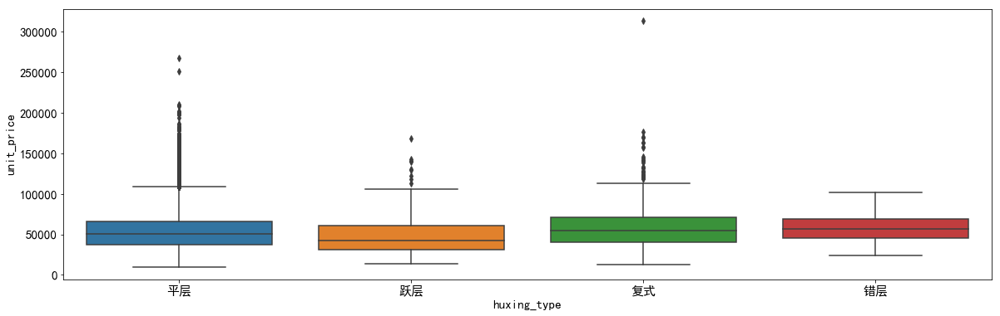

In [33]:
plt.figure(figsize=(20,6))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
huxing_type=['平层','跃层','复式','错层']
sns.boxplot(df.huxing_type,df.unit_price,order = huxing_type)

In [34]:
huxing=df["huxing_type"].value_counts()
huxing.pop("暂无数据")
from pyecharts import Pie
huxing_plot=Pie('huxing_type',width=900)
huxing_plot.add(name='building_type',attr=huxing.index,value=huxing.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
huxing_plot

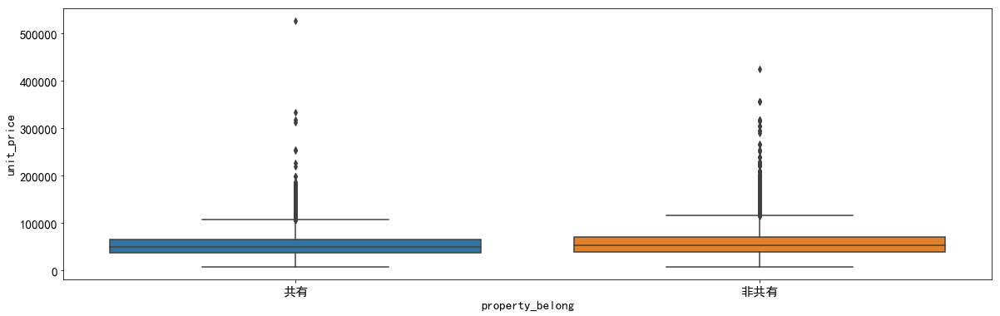

In [38]:
plt.figure(figsize=(20,6))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
property_belong=['共有','非共有']
sns.boxplot(df.property_belong,df.unit_price,order=property_belong)

In [39]:
property=df["property_belong"].value_counts()
property.pop("暂无数据")
from pyecharts import Pie
property_plot=Pie('property_belong',width=900)
property_plot.add(name='building_type',attr=property.index,value=property.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
property_plot

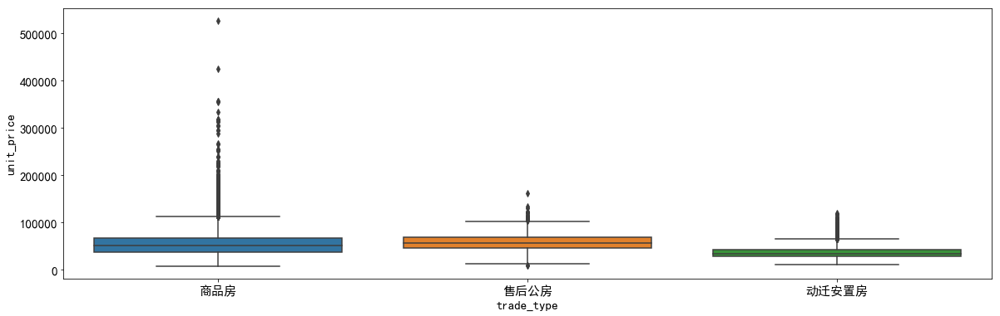

In [40]:
plt.figure(figsize=(20,6))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
trade_type=['商品房', '售后公房', '动迁安置房']
sns.boxplot(df.trade_type,df.unit_price,order=trade_type)

In [42]:
trade=df["trade_type"].value_counts()
#trade.pop("暂无数据")
from pyecharts import Pie
trade_plot=Pie('trade_type',width=900)
trade_plot.add(name='building_type',attr=trade.index,value=trade.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
trade_plot

In [8]:
df_heatmap=df[['unit_price','total_price','huxing_shi','huxing_ting','huxing_chu','huxing_wei','floor_float','building_area_float','elevator_rate.1','dist_sta','dist_cent']]
from pyecharts import HeatMap
heatmap=HeatMap('各因素相关性热力图',width=600,height=600)
heatmap_corr=df_heatmap.corr()
heatmap_data=[]
length=11
for i in range(length):
    for j in range(length):
        heatmap_data.append([i,j,heatmap_corr.iloc[i,j]])
heatmap.add('相关系数',heatmap_corr.columns.tolist(),heatmap_corr.columns.tolist(),heatmap_data,is_visualmap=True,visual_range=[-1,1],visual_orient='horizontal')
heatmap

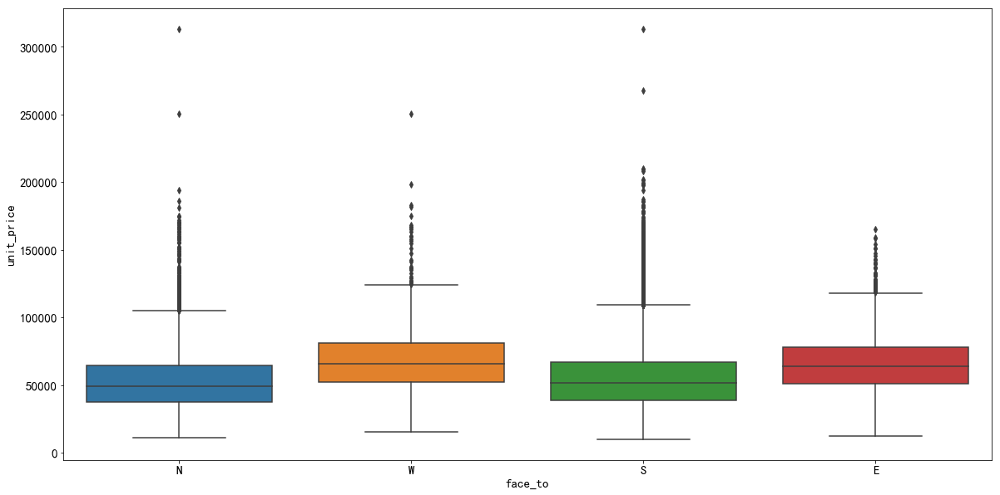

In [45]:
plt.figure(figsize=(20,10))
plt.rc("font",family="SimHei",size="15")  #解决中文乱码问题
#property_belong=['共有','非共有'
#face = list(df[df['face_N'] == 1].face_N)

#face.update(dict(df[df['face_S'] == 1].face_S))
#face.update(dict(df[df['face_W'] == 1].face_W))
#face.update(dict(df[df['face_E'] == 1].face_E))
unit_price_N = list(df[df['face_N'] == 1].unit_price)
unit_price_W = list(df[df['face_W'] == 1].unit_price)
unit_price_S = list(df[df['face_S'] == 1].unit_price)
unit_price_E = list(df[df['face_E'] == 1].unit_price)
face_to = []
face_to = ['N']*len(unit_price_N)
face_to.extend(['W']*len(unit_price_W))
face_to.extend(['S']*len(unit_price_S))
face_to.extend(['E']*len(unit_price_E))
unit_price = unit_price_N
unit_price.extend(unit_price_W)
unit_price.extend(unit_price_S)
unit_price.extend(unit_price_E)

c = {
    "face_to":face_to,
    "unit_price":unit_price,
}
from pandas.core.frame import DataFrame
data = DataFrame(c)
#unit_price.update(dict(df[df['face_N'] == 1].unit_price))

#face = dict(dict(df[df['face_N'] == 1].face_N).items() + dict(df[df['face_S'] == 1].face_S).items() + dict(df[df['face_W'] == 1].face_W).items()+dict(df[df['face_E'] == 1].face_E).items())
#unit_price = dict(dict(df[df['face_N'] == 1].unit_price).items() + dict(df[df['face_S'] == 1].unit_price).items() + dict(df[df['face_W'] == 1].unit_price).items()+dict(df[df['face_E'] == 1].unit_price).items())
sns.boxplot(data.face_to,data.unit_price)

In [46]:
trade=data["face_to"].value_counts()
#trade.pop("暂无数据")
from pyecharts import Pie
trade_plot=Pie('face_to',width=900)
trade_plot.add(name='building_type',attr=trade.index,value=trade.values,center=[50,60],radius=[40,80],is_random=True,rosetype='radius',is_label_show=True)
trade_plot

skew:  2.259552502275325


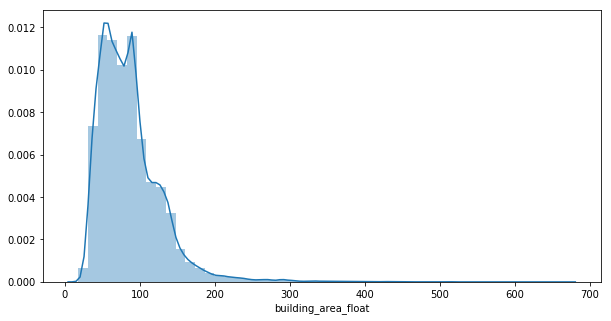

In [9]:
plt.figure(figsize = (10,5))
print("skew: ",df.building_area_float.skew())
sns.distplot(df['building_area_float'])